In [36]:
import networkx as nx
import matplotlib.pyplot as plt

import networkx.algorithms.community as nx_comm
import networkx.algorithms.assortativity as nx_ass

import os

try:
    import community as community_louvain
except ImportError:
    os.system('pip install python-louvain')
    import community as community_louvain
    
import numpy as np
import math

In [2]:
def fixedG(oldG):
    # A veces hay aristas repetidas y networkx lee el archivo como
    # "multigrafo", para el cual no funciona k-cores. Así que genero
    # acá una copia simplificada.
    Gsimp = nx.Graph()
    for u,v,data in oldG.edges(data=True):
        if not Gsimp.has_edge(u,v):
            Gsimp.add_edge(u, v)
            
    return Gsimp

In [3]:
def maxKcoreDepth(G):
    iterI = 1
    while nx.k_core(G,iterI).number_of_nodes()!=0: iterI+=1
    return iterI

In [4]:
def meanKCoreShellPlot(G, k_max, netName):
    k_mean = math.ceil(k_max/2)

    fig, axs = plt.subplots(1,2, figsize=(50,25), dpi=60)

    fig.suptitle("Network: {}".format(netName,k_mean), fontsize=60)

    G_kc_mean = nx.k_core(G, k=k_mean)
    nx.draw(G_kc_mean, ax=axs[0], with_labels=True, node_color="skyblue", pos = nx.fruchterman_reingold_layout(G_kc_mean, iterations=100))
    axs[0].set_title('K-core (k={})'.format(k_mean), fontsize=40)

    G_ks_mean = nx.k_shell(G, k=k_mean)
    nx.draw(G_ks_mean, ax=axs[1], with_labels=True, node_color="skyblue", pos = nx.fruchterman_reingold_layout(G_ks_mean, iterations=100))
    axs[1].set_title('K-shell (k={})'.format(k_mean), fontsize=40)
    
    fig.show()

In [5]:
def set_node_community(G, communities):
    '''Add community to node attributes'''
    for c, v_c in enumerate(communities):
        for v in v_c:
            # Add 1 to save 0 for external edges
            G.nodes[v]['community'] = c + 1

def set_edge_community(G):
    '''Find internal edges and add their community to their attributes'''
    for v, w, in G.edges:
        if G.nodes[v]['community'] == G.nodes[w]['community']:
            # Internal edge, mark with community
            G.edges[v, w]['community'] = G.nodes[v]['community']
        else:
            # External edge, mark as 0
            G.edges[v, w]['community'] = 0

def get_color(i, r_off=1, g_off=1, b_off=1):
    '''Assign a color to a vertex.'''
    r0, g0, b0 = 0, 0, 0
    n = 16
    low, high = 0.1, 0.9
    span = high - low
    r = low + span * (((i + r_off) * 3) % n) / (n - 1)
    g = low + span * (((i + g_off) * 5) % n) / (n - 1)
    b = low + span * (((i + b_off) * 7) % n) / (n - 1)
    return (r, g, b)

In [6]:
def plotCommunities(G, nameG):
    # Find the communities
    communities = sorted(nx_comm.greedy_modularity_communities(G), key=len, reverse=True)

    count_node_com = [str(len(i)) for i in communities]
    mod_Q = nx_comm.modularity(G, communities)

    # Set node and edge communities
    set_node_community(G, communities)
    set_edge_community(G)

    node_color = [get_color(G.nodes[v]['community']) for v in G.nodes]

    # Set community color for edges between members of the same community (internal) and intra-community edges (external)
    external = [(v, w) for v, w in G.edges if G.edges[v, w]['community'] == 0]
    internal = [(v, w) for v, w in G.edges if G.edges[v, w]['community'] > 0]
    internal_color = ['black' for e in internal]

    #G_pos = nx.spring_layout(G)
    G_pos = nx.fruchterman_reingold_layout(G, iterations=100)

    plt.subplots(figsize=(50,25), dpi=60)

    #    fig, axs = plt.subplots(1,2, figsize=(50,25), dpi=60)
    title_str = "Network: {0}\n Communities Count: {1}\n Length Communities: {2}\n Modularity (Q): {3}\n".format(
                nameG, len(communities), '[' + ' - '.join(count_node_com) + ']', round(mod_Q,5))
    plt.title(title_str, fontsize=60)

    # Draw external edges
    nx.draw_networkx(
        G,
        pos=G_pos,
        node_size=0,
        edgelist=external,
        edge_color="silver")
    # Draw nodes and internal edges
    nx.draw_networkx(
        G,
        pos=G_pos,
        node_color=node_color,
        edgelist=internal,
        edge_color=internal_color)

    plt.show()

In [35]:
def community_layout(g, partition):
    """
    Compute the layout for a modular graph.


    Arguments:
    ----------
    g -- networkx.Graph or networkx.DiGraph instance
        graph to plot

    partition -- dict mapping int node -> int community
        graph partitions


    Returns:
    --------
    pos -- dict mapping int node -> (float x, float y)
        node positions

    """

    pos_communities = _position_communities(g, partition, scale=3.)

    pos_nodes = _position_nodes(g, partition, scale=1.)

    # combine positions
    pos = dict()
    for node in g.nodes():
        pos[node] = pos_communities[node] + pos_nodes[node]

    return pos

def _position_communities(g, partition, **kwargs):

    # create a weighted graph, in which each node corresponds to a community,
    # and each edge weight to the number of edges between communities
    between_community_edges = _find_between_community_edges(g, partition)

    communities = set(partition.values())
    hypergraph = nx.DiGraph()
    hypergraph.add_nodes_from(communities)
    for (ci, cj), edges in between_community_edges.items():
        hypergraph.add_edge(ci, cj, weight=len(edges))

    # find layout for communities
    pos_communities = nx.spring_layout(hypergraph, **kwargs)

    # set node positions to position of community
    pos = dict()
    for node, community in partition.items():
        pos[node] = pos_communities[community]

    return pos

def _find_between_community_edges(g, partition):

    edges = dict()

    for (ni, nj) in g.edges():
        ci = partition[ni]
        cj = partition[nj]

        if ci != cj:
            try:
                edges[(ci, cj)] += [(ni, nj)]
            except KeyError:
                edges[(ci, cj)] = [(ni, nj)]

    return edges

def _position_nodes(g, partition, **kwargs):
    """
    Positions nodes within communities.
    """

    communities = dict()
    for node, community in partition.items():
        try:
            communities[community] += [node]
        except KeyError:
            communities[community] = [node]

    pos = dict()
    for ci, nodes in communities.items():
        subgraph = g.subgraph(nodes)
        pos_subgraph = nx.spring_layout(subgraph, **kwargs)
        pos.update(pos_subgraph)

    return pos

## Pregunta 4

Importamos la red usanda en la tarea 1 (red 02 - colaboracion jazz):

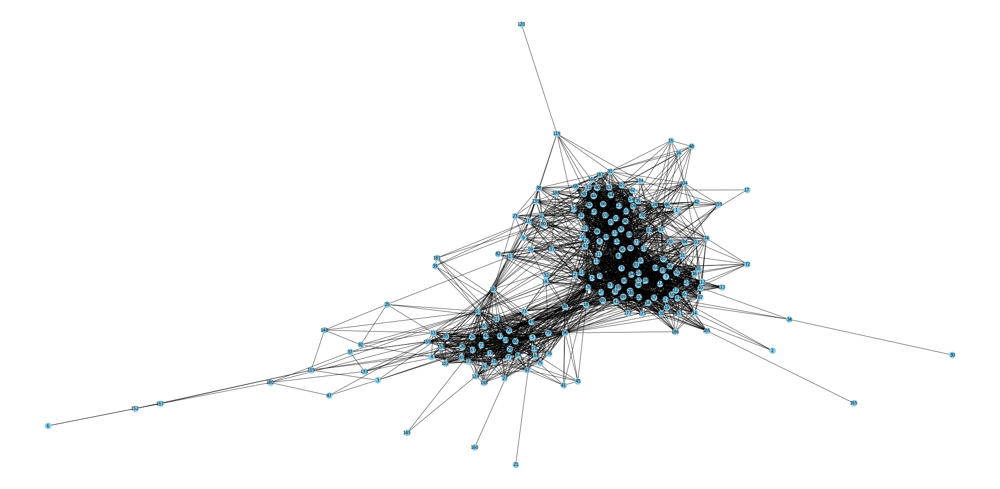

In [7]:
t1_G = fixedG(nx.read_pajek("Net02T1.net").to_undirected())

plt.subplots(figsize=(50,25), dpi=60)
nx.draw(t1_G, with_labels=True, node_color="skyblue", pos = nx.fruchterman_reingold_layout(t1_G, iterations=100))
plt.show()

Generamos las 10 redes aleatorias apartir del graddo de `t1_G`:

In [8]:
G_10_l = [nx.configuration_model([d for v, d in t1_G.degree()], create_using=nx.classes.graph.Graph).to_undirected() for i in range(10)]

def remove_loop_f(G):
    G = nx.Graph(G)
    G.remove_edges_from(nx.selfloop_edges(G))
    return G
G_10_l = list(map(remove_loop_f, G_10_l))

### Nucleo/Periferia

In [9]:
k_max = maxKcoreDepth(t1_G)
print('Original Net: ')
print('[+]Depth K-Core: {}'.format(k_max))
l_k_shell = [nx.k_shell(t1_G, k=i).number_of_nodes() for i in range(1,k_max+1)]
print('[+]List K-shell:',l_k_shell)

for n_i in range(len(G_10_l)):
    aux_net = G_10_l[n_i]
    k_max = maxKcoreDepth(aux_net)
    print('Random Net #{}'.format(n_i + 1))
    print('[+]Depth K-Core: {}'.format(k_max))
    l_k_shell = [nx.k_shell(aux_net, k=i).number_of_nodes() for i in range(1,k_max+1)]
    print('[+]List K-shell:',l_k_shell)

Original Net: 
[+]Depth K-Core: 30
[+]List K-shell: [5, 5, 4, 7, 0, 3, 2, 5, 1, 2, 5, 2, 5, 5, 17, 3, 30, 7, 3, 14, 43, 0, 0, 0, 0, 0, 0, 0, 30, 0]
Random Net #1
[+]Depth K-Core: 18
[+]List K-shell: [5, 3, 4, 3, 4, 4, 5, 4, 0, 2, 7, 5, 7, 4, 5, 11, 125, 0]
Random Net #2
[+]Depth K-Core: 19
[+]List K-shell: [5, 3, 3, 4, 3, 6, 4, 2, 4, 3, 4, 5, 2, 7, 6, 14, 10, 113, 0]
Random Net #3
[+]Depth K-Core: 18
[+]List K-shell: [5, 3, 3, 3, 4, 6, 3, 5, 1, 2, 5, 3, 9, 4, 3, 22, 117, 0]
Random Net #4
[+]Depth K-Core: 19
[+]List K-shell: [5, 3, 3, 3, 5, 4, 4, 2, 5, 1, 4, 10, 2, 5, 3, 18, 20, 101, 0]
Random Net #5
[+]Depth K-Core: 19
[+]List K-shell: [5, 3, 3, 4, 4, 4, 6, 3, 1, 1, 7, 1, 7, 4, 8, 14, 29, 94, 0]
Random Net #6
[+]Depth K-Core: 19
[+]List K-shell: [5, 3, 3, 3, 4, 6, 4, 3, 2, 3, 2, 5, 8, 6, 7, 9, 12, 113, 0]
Random Net #7
[+]Depth K-Core: 19
[+]List K-shell: [5, 3, 3, 3, 4, 5, 5, 2, 2, 5, 3, 3, 5, 11, 8, 16, 17, 98, 0]
Random Net #8
[+]Depth K-Core: 19
[+]List K-shell: [5, 3, 3, 4, 4, 5, 

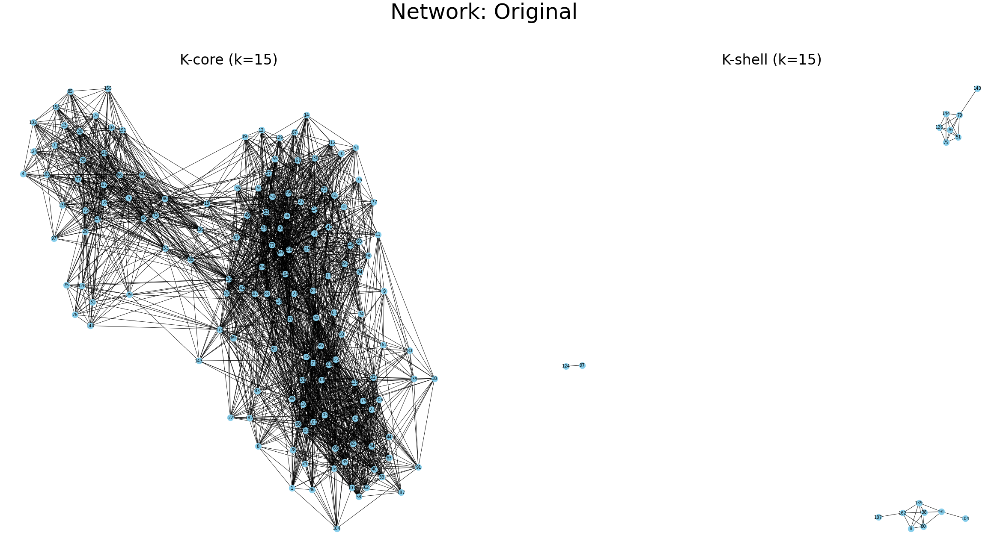

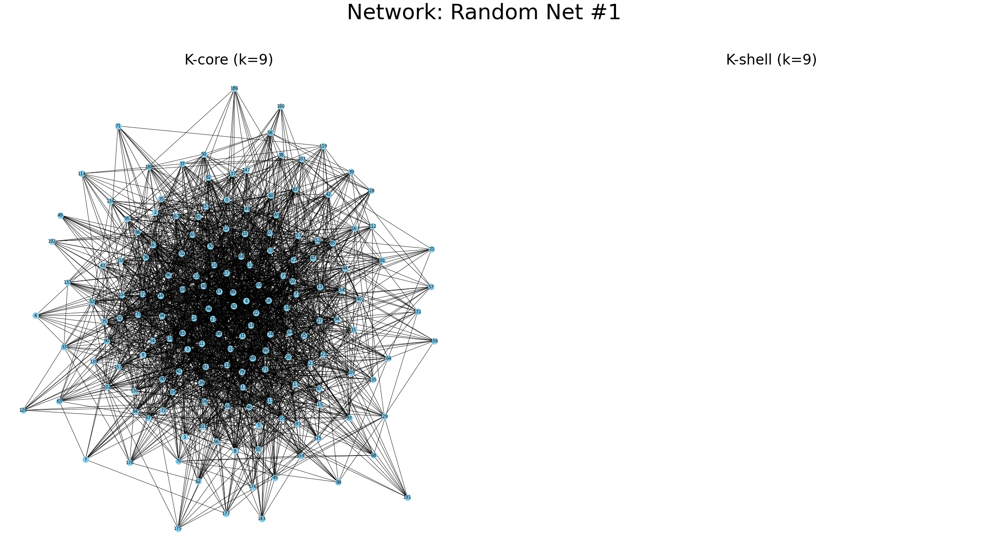

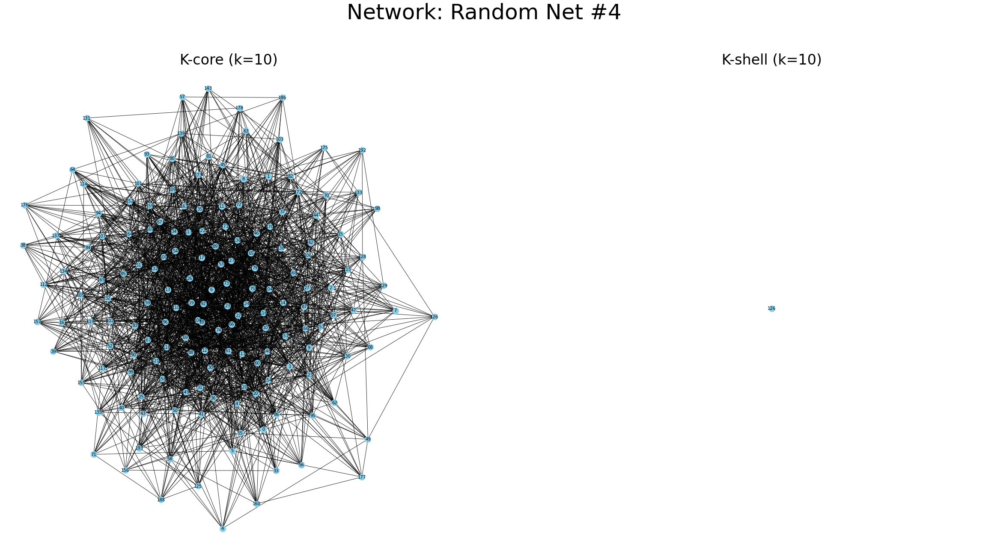

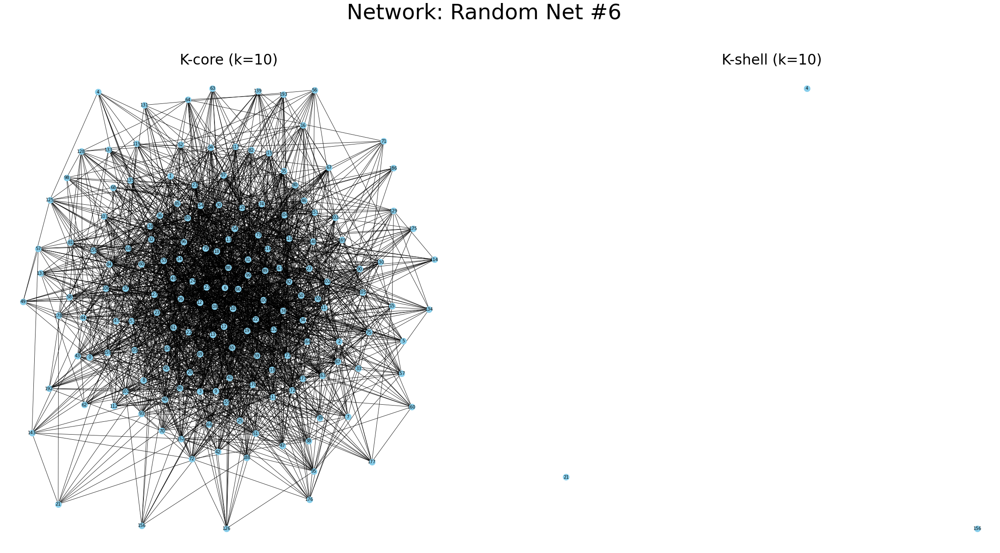

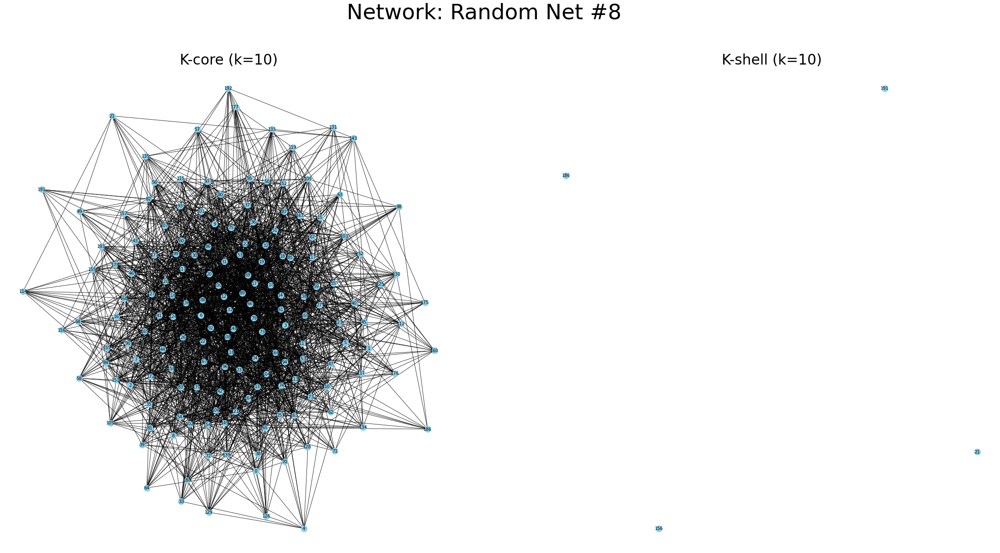

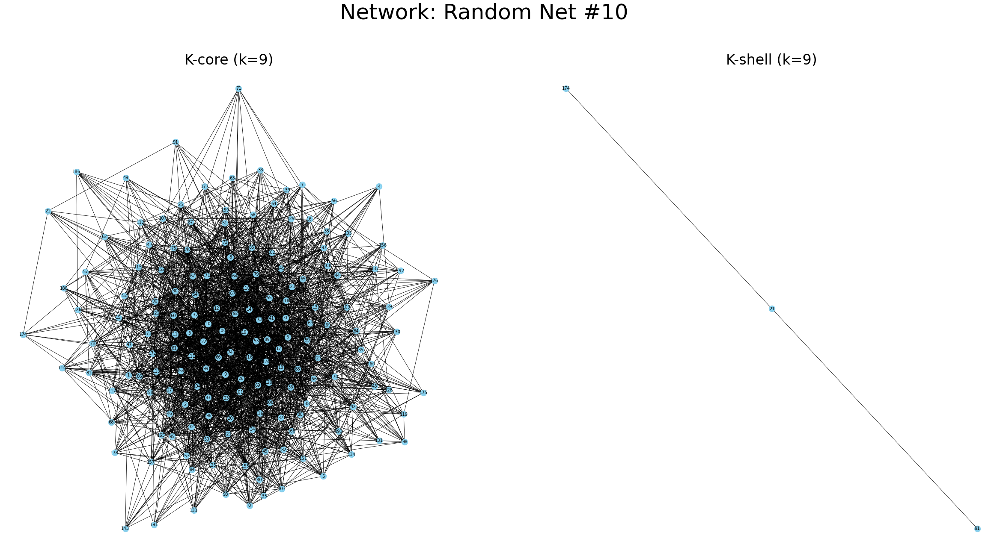

In [10]:
k_max = maxKcoreDepth(t1_G)
meanKCoreShellPlot(t1_G, k_max, 'Original')

for i in [0,3,5,7,9]:
    aux_net = G_10_l[i]
    k_max = maxKcoreDepth(aux_net)
    meanKCoreShellPlot(aux_net, k_max, 'Random Net #{}'.format(i + 1))

### Comunidades

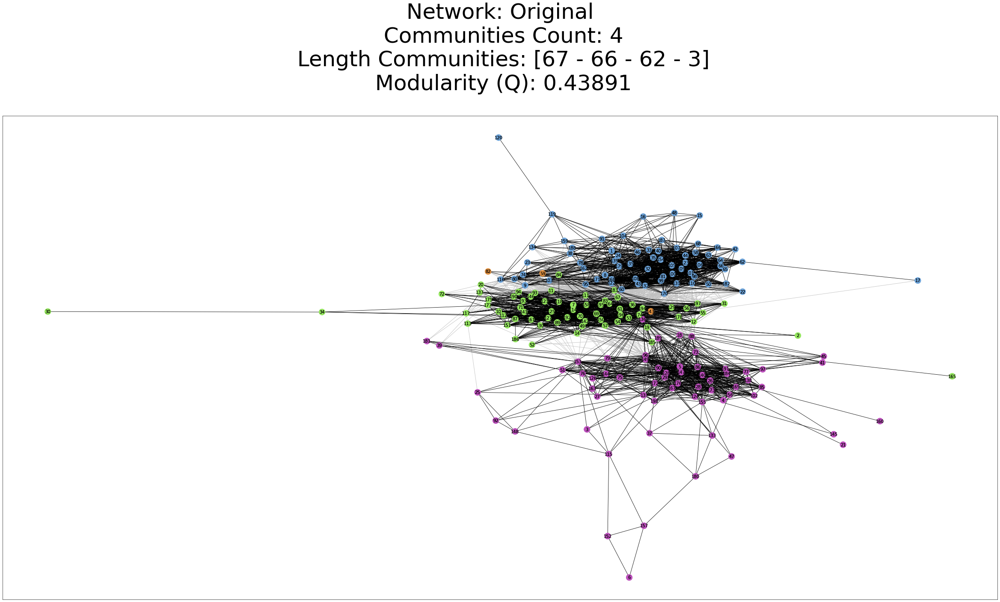

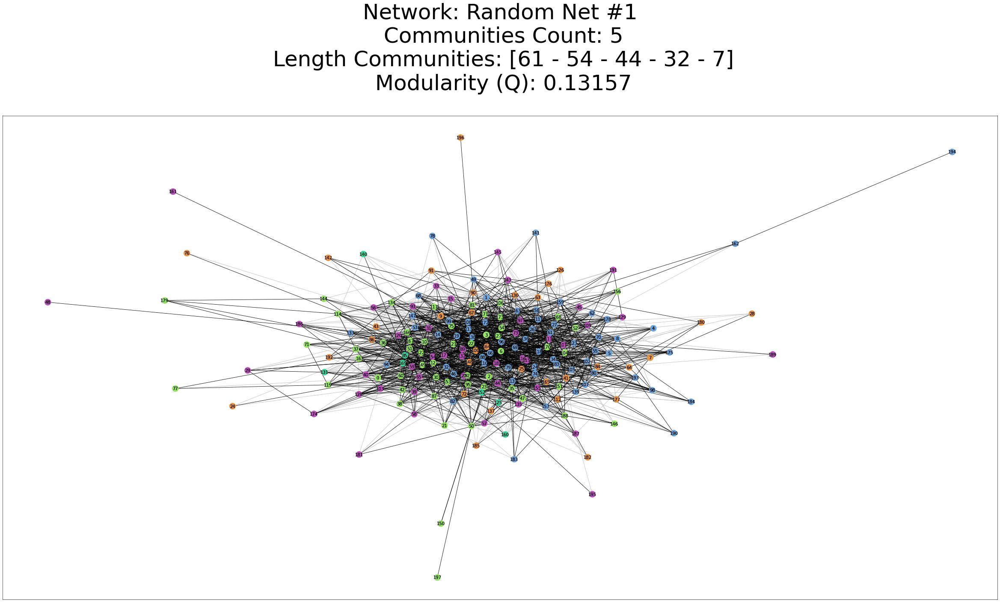

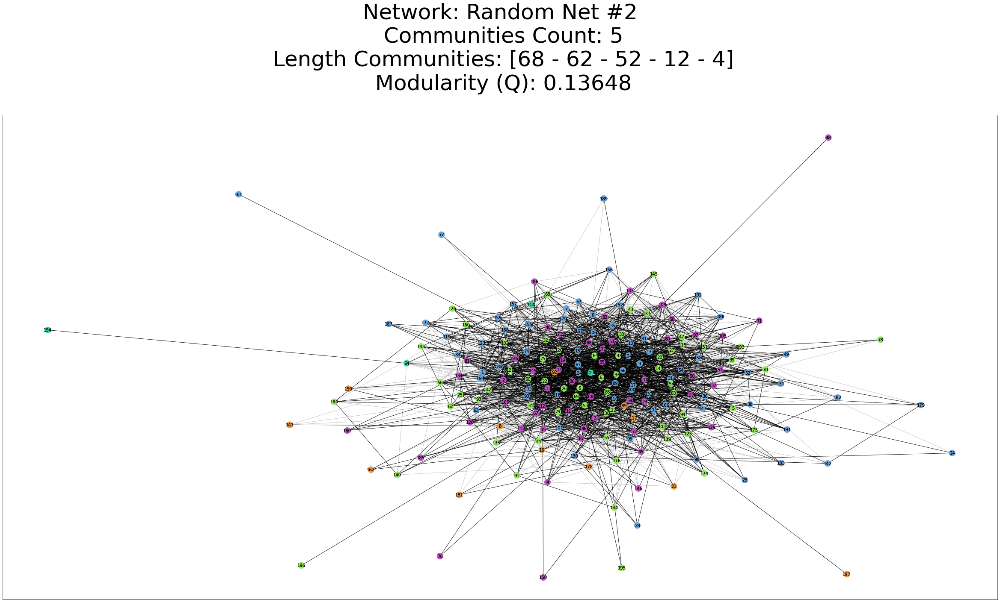

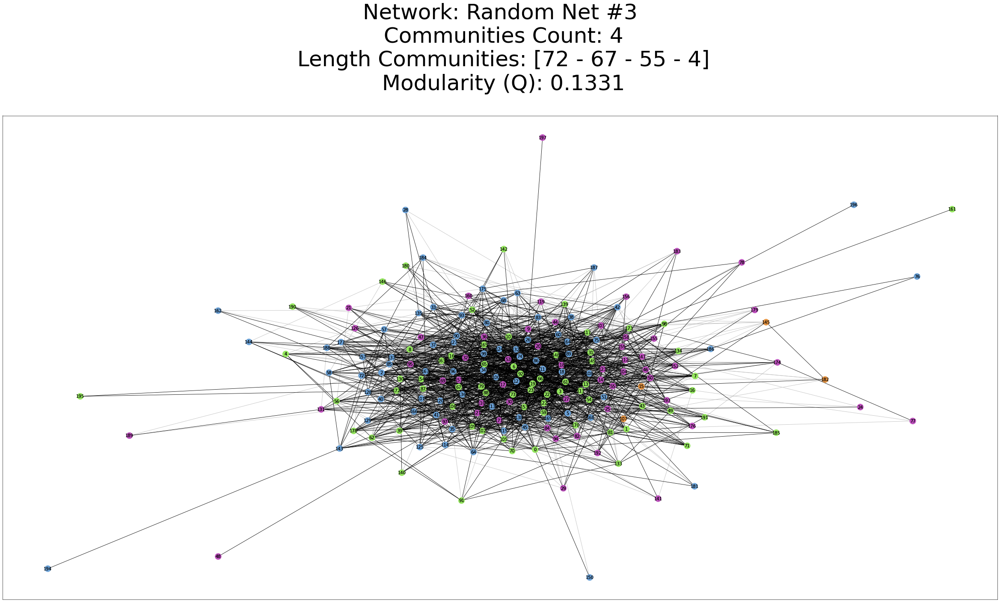

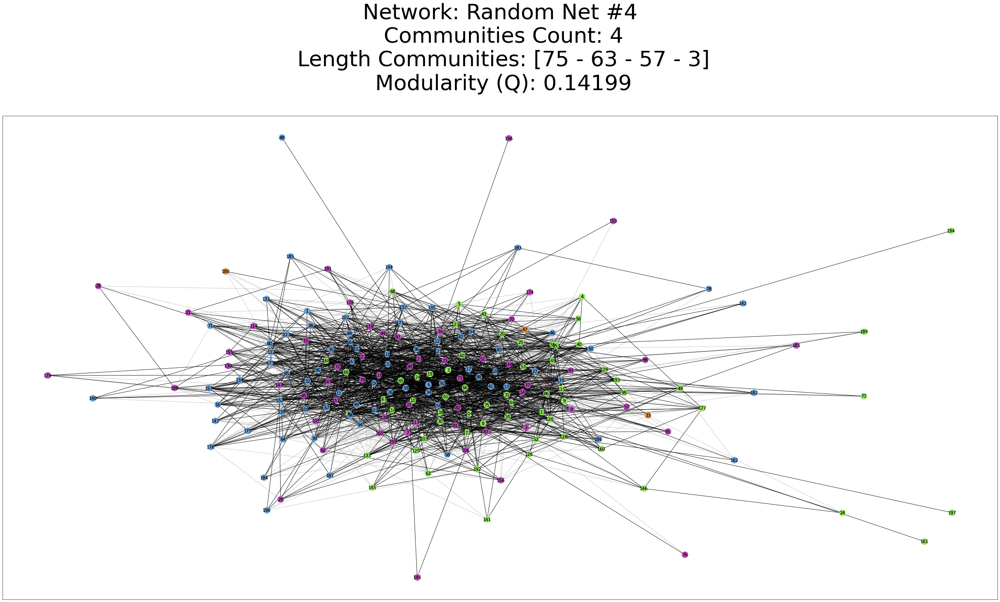

...

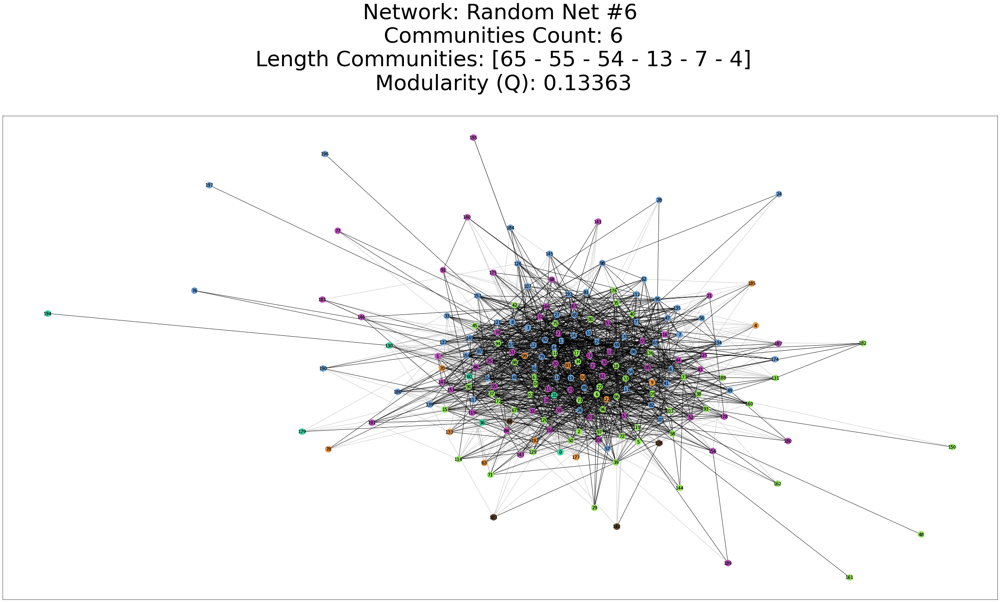

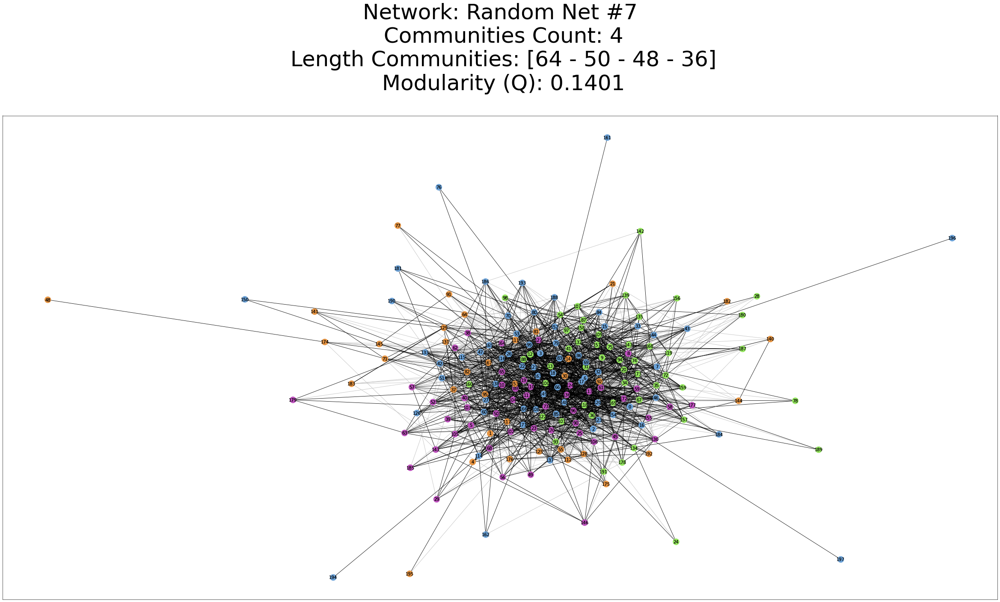

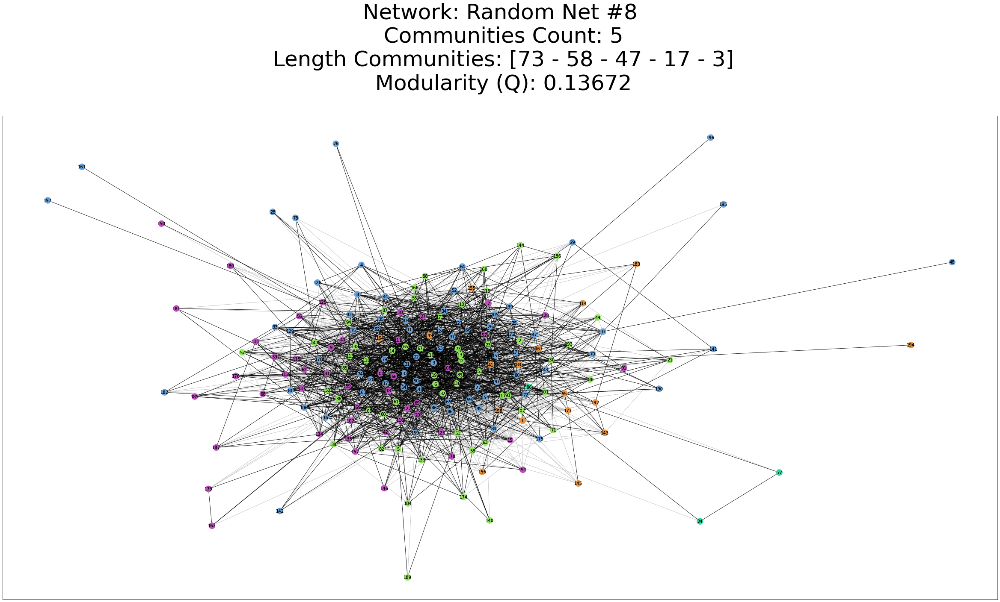

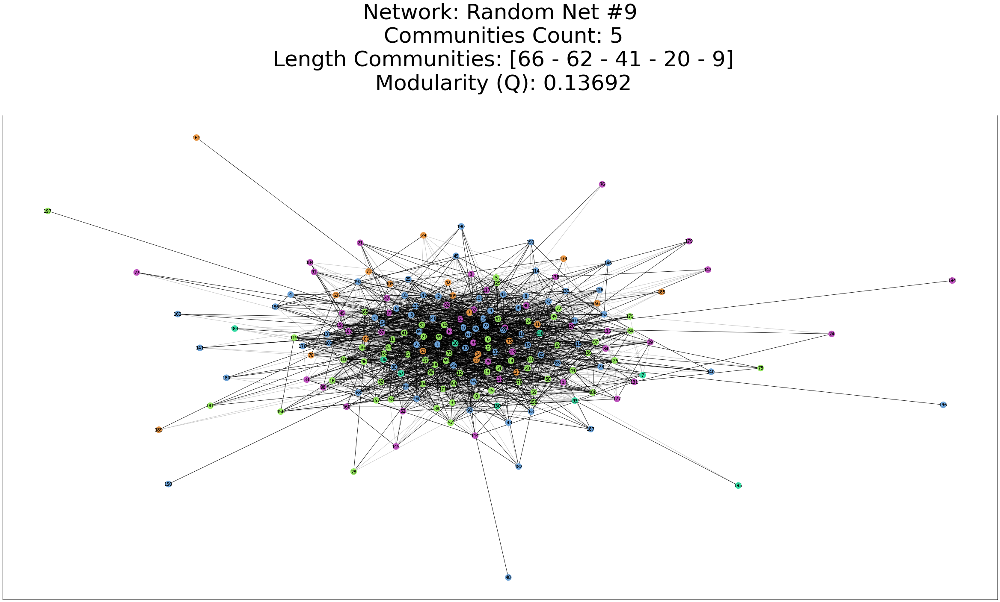

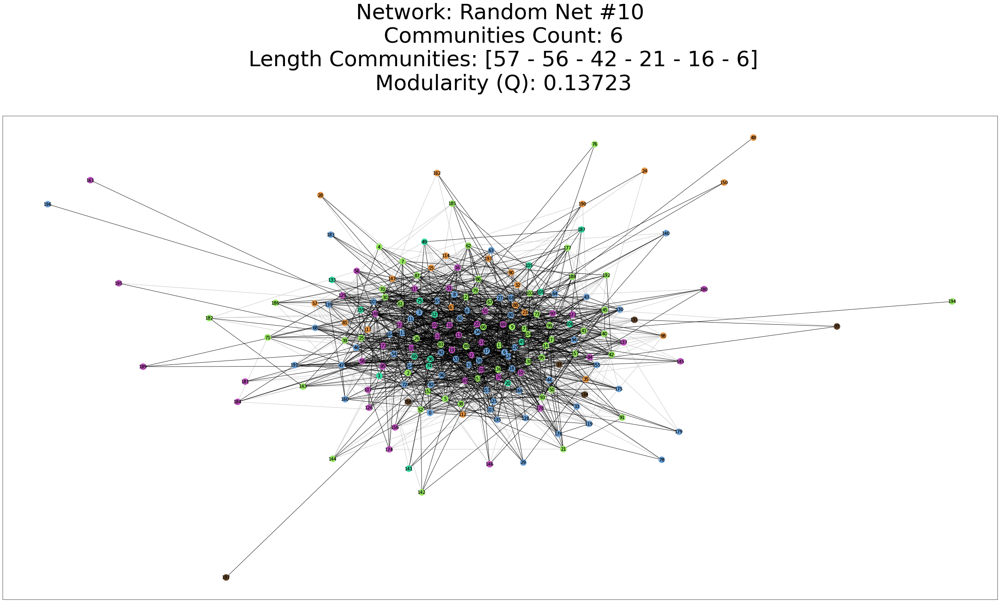

In [11]:
plotCommunities(t1_G, 'Original')

for n_i in range(len(G_10_l)):
    aux_net = G_10_l[n_i]
    plotCommunities(aux_net, 'Random Net #{}'.format(n_i + 1))

### Asortatividad

In [14]:
print('Original net Pearson Degree:', nx_ass.degree_pearson_correlation_coefficient(t1_G))
print('Original net Newman Degree:', nx_ass.degree_assortativity_coefficient(t1_G))

Original net Pearson Degree: 0.020237399275047283
Original net Newman Degree: 0.02023739927504758


In [16]:
for n_i in range(len(G_10_l)):
    aux_net = G_10_l[n_i]
    
    print('Random Net #{} Pearson Degree:'.format(n_i + 1), nx_ass.degree_pearson_correlation_coefficient(aux_net))
    print('Random Net #{} Newman Degree:'.format(n_i + 1), nx_ass.degree_assortativity_coefficient(aux_net))
    print('\n')

Random Net #1 Pearson Degree: -0.05896271936353248
Random Net #1 Newman Degree: -0.05896271936353113


Random Net #2 Pearson Degree: -0.05159509307142056
Random Net #2 Newman Degree: -0.05159509307142149


Random Net #3 Pearson Degree: -0.03859654372795014
Random Net #3 Newman Degree: -0.03859654372794937


Random Net #4 Pearson Degree: -0.04899622022927734
Random Net #4 Newman Degree: -0.04899622022927848


Random Net #5 Pearson Degree: -0.04953779980704445
Random Net #5 Newman Degree: -0.049537799807046305


Random Net #6 Pearson Degree: -0.06854580151227689
Random Net #6 Newman Degree: -0.0685458015122764


Random Net #7 Pearson Degree: -0.03238496830548347
Random Net #7 Newman Degree: -0.03238496830548379


Random Net #8 Pearson Degree: -0.04219688446115248
Random Net #8 Newman Degree: -0.04219688446115449


Random Net #9 Pearson Degree: -0.04074970711842044
Random Net #9 Newman Degree: -0.04074970711842396


Random Net #10 Pearson Degree: -0.03236687196174666
Random Net #10 Newman

In [17]:
nx_ass.k_nearest_neighbors(t1_G)

{23: 39.04830917874396,
 21: 45.166666666666664,
 29: 40.08275862068965,
 43: 41.24031007751938,
 12: 39.69444444444444,
 96: 36.927083333333336,
 20: 34.325,
 26: 43.67948717948718,
 42: 40.0,
 40: 35.16,
 46: 37.81304347826087,
 60: 41.43333333333333,
 49: 42.8469387755102,
 56: 43.0,
 75: 40.50666666666667,
 10: 33.85,
 74: 38.067567567567565,
 45: 36.111111111111114,
 3: 21.444444444444443,
 25: 38.536,
 39: 39.123931623931625,
 4: 27.25,
 7: 33.61904761904762,
 41: 36.05487804878049,
 16: 34.703125,
 31: 37.76702508960574,
 19: 34.067669172932334,
 22: 33.11363636363637,
 24: 35.516666666666666,
 1: 25.6,
 13: 37.51282051282051,
 28: 38.607142857142854,
 37: 40.927927927927925,
 17: 40.423529411764704,
 33: 41.621212121212125,
 52: 36.29807692307692,
 18: 37.833333333333336,
 100: 34.18,
 54: 30.62962962962963,
 36: 43.19444444444444,
 2: 34.166666666666664,
 57: 38.578947368421055,
 27: 43.93333333333333,
 32: 43.708333333333336,
 53: 41.34905660377358,
 62: 39.5,
 30: 40.5333333

## Pregunta 6

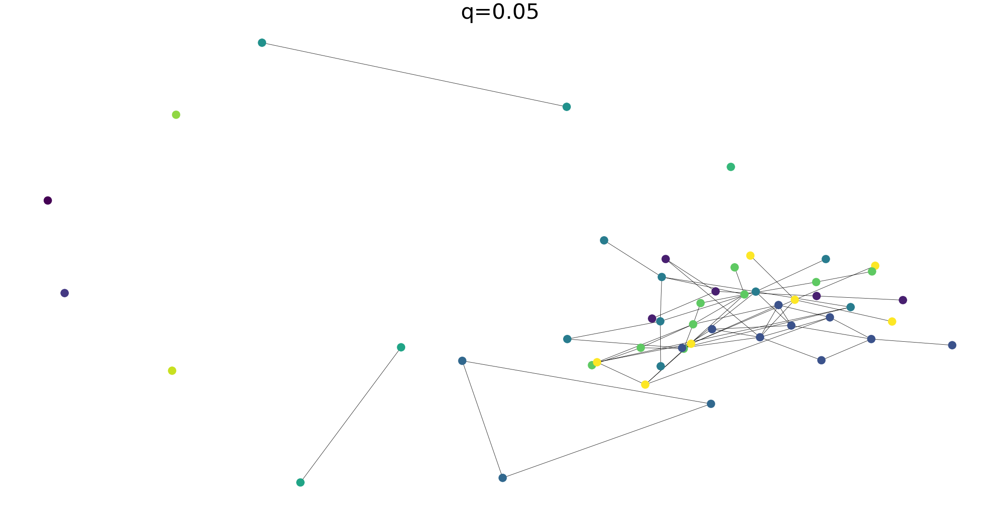

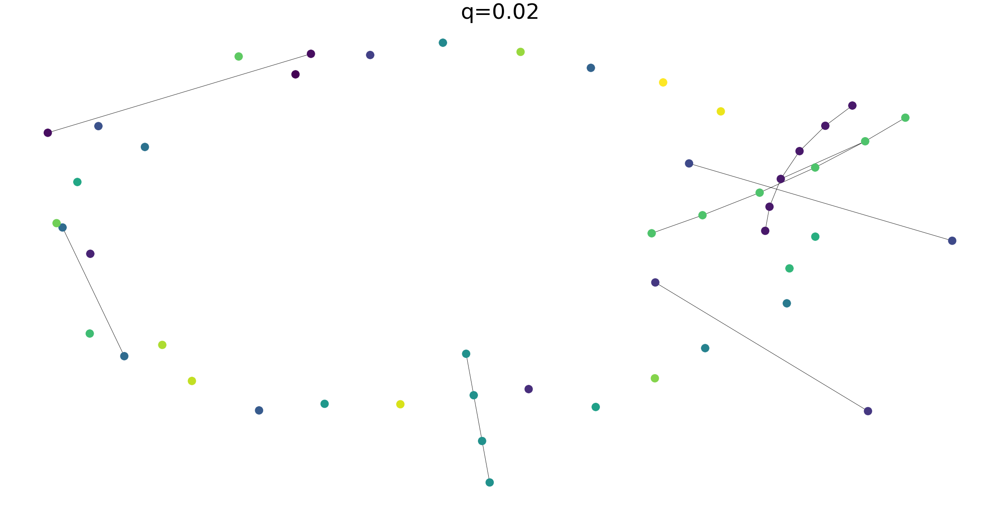

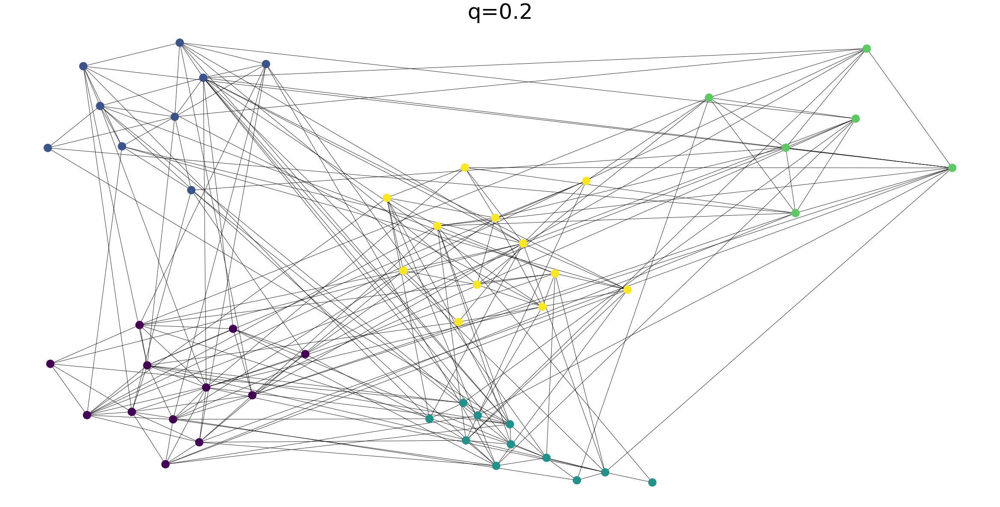

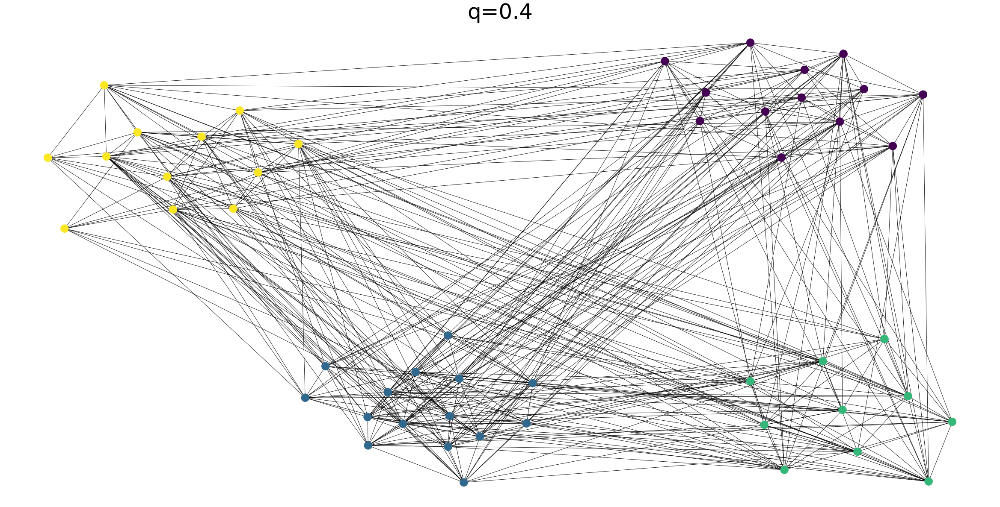

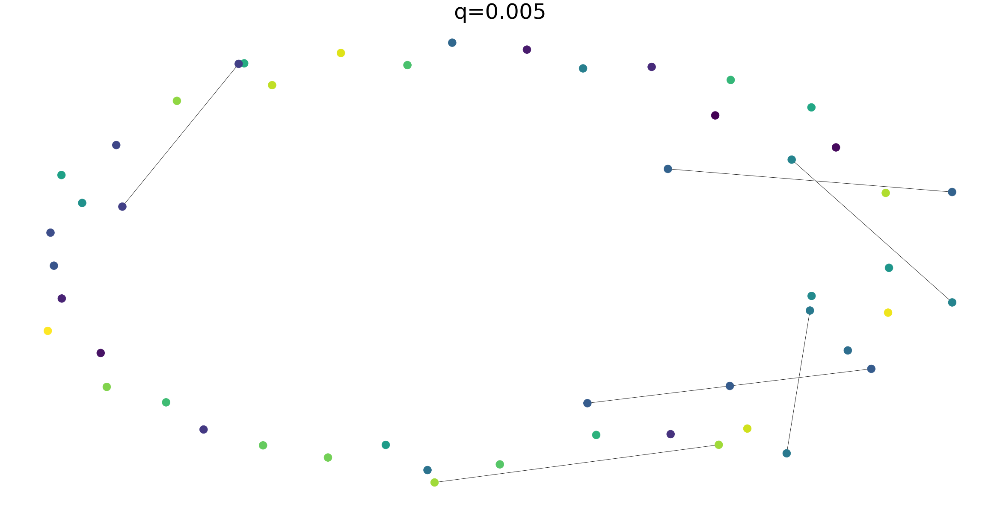

In [45]:
for q in [0.05, 0.02, 0.2, 0.4, 0.005]:
    community_sizes = [10, 10, 10, 10, 10]
    community_probs =[[0.02 if j==i else q for j in range(len(community_sizes)) ] for i in range(len(community_sizes))]

    G_sbm = nx.stochastic_block_model(community_sizes, community_probs)

    partition = community_louvain.best_partition(G_sbm)
    pos = community_layout(G_sbm, partition)

    plt.subplots(figsize=(50,25), dpi=60)
    plt.title('q={}'.format(q), fontsize=60)
    nx.draw(G_sbm, pos,node_size=500, node_color=list(partition.values()))
    plt.show()